In [1]:
!pip install einops
!pip install timm
!pip install albumentations
!pip install segmentation_models_pytorch

In [2]:
import random
import numpy as np
import pydicom
from torch.nn.modules.loss import CrossEntropyLoss
from torch.utils.data import DataLoader, random_split
import torch
import torch.nn as nn
import torch.optim as optim
from tqdm import tqdm
import torch.nn.functional as F
import albumentations
import matplotlib.pyplot as plt
import cv2

import segmentation_models_pytorch as smp


In [3]:
def transform_to_hu(medical_image, image):
    hu_image = image * medical_image.RescaleSlope + medical_image.RescaleIntercept
    hu_image[hu_image < -1024] = -1024
    return hu_image

def apply_window(image, window_center, window_width):
    window_image = image.copy()
    image_min = window_center - (window_width / 2)
    image_max = window_center + (window_width / 2)
    window_image[window_image < image_min] = image_min
    window_image[window_image > image_max] = image_max
    return window_image

def resize_normalize(image):
    image = np.array(image, dtype=np.float64)
    image -= np.min(image)
    image /= np.max(image)
    return image

def read_dicom(path, window_width, window_level):
    image_medical = pydicom.dcmread(path)
    image_data = image_medical.pixel_array

    image_hu = transform_to_hu(image_medical, image_data)
    image_window = apply_window(image_hu.copy(), window_level, window_width)
    image_window_norm = resize_normalize(image_window)

    image_window_norm = np.expand_dims(image_window_norm, axis=2)   # (512, 512, 1)
    image_ths = np.concatenate([image_window_norm, image_window_norm, image_window_norm], axis=2)   # (512, 512, 3)
    return image_ths

In [4]:
config = {"path": 'data',
          "window_width": 400,
          "window_label": 40,
          "num_classes": 4,
          "max_epochs": 150,
          "batch_size": 16,
          "lr": 0.001,
          "image_size": 512,
          "seed": 42
         }

In [5]:
random.seed(42)
np.random.seed(42)
torch.manual_seed(42)
torch.cuda.manual_seed(42)

torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False

device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
print(device)


albumentation_transform = albumentations.Compose([
    albumentations.HorizontalFlip(p=0.5),
    albumentations.VerticalFlip(p=0.5),
    albumentations.Rotate(p=1.0,limit=90,border_mode=cv2.BORDER_CONSTANT,mask_value=0),
    albumentations.Affine(scale=(0.8,1.0))
],additional_targets = {'label':'image'})

train_transform = albumentations.Compose([
    albumentations.GaussNoise(var_limit=(0.1,0.5))
])

data_list = np.random.permutation(100)
train_list = data_list[:90]
val_list = data_list[90:]

print(len(train_list))

cuda:0
90


torch.Size([512, 512, 3])
torch.Size([512, 512, 3])
torch.Size([4, 512, 512])


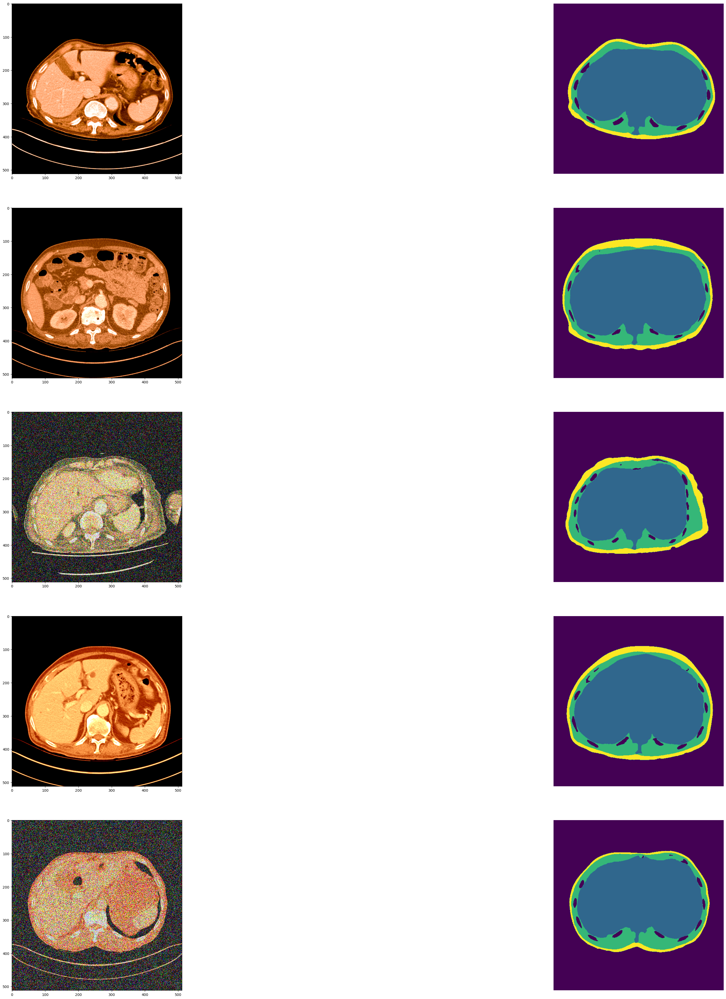

In [16]:
# import numpy as np
import pandas as pdb
import os
import cv2
import torch
import torch.utils.data as data

class MorphometryDataset(data.Dataset):
    def __init__(self,path,window_width,window_label,image_size,transform,train_transform,train_list):
        self.path=path
        self.window_width = window_width
        self.window_label = window_label
        self.width,self.height=image_size,image_size
        self.transform = transform
        self.train_transform = train_transform
        self.train_list = train_list
        
    #index:0~99,image:(512,512,3), label:(512,512)
    def __getitem__(self,index):
        index = (index%90)
        index = self.train_list[index]+1
        
        file_number = 'case'+str(index//100)+str((index%100)//10)+str(index%10)
        file_name = os.path.join(self.path,'train/dcm',file_number+'.dcm')
        window_width = random.randrange(200,600)
        window_label = random.randrange(-196,-64)
        image1 = read_dicom(file_name,window_width,window_label)
        window_width = random.randrange(200,600)
        window_label = random.randrange(-64,64)
        image2 = read_dicom(file_name,window_width,window_label)
        window_width = random.randrange(200,600)
        window_label = random.randrange(64,196)
        image3 = read_dicom(file_name,window_width,window_label)
        
        label_name = os.path.join(self.path,'train/label',file_number+'.png')
        label = cv2.imread(label_name)
        
        image1[:,:,1] = image2[:,:,0]
        image1[:,:,2] = image3[:,:,0]
        image = image1
        label = label[:,:,0]
        
        aug1 = self.train_transform(image=image)
        image = aug1['image']
        
        label_ = label
        
        one_label = []
        for i in range(4):
            one = np.zeros(label_.shape)
            one[label_==i]=1
            one_label.append(one)
        
        #label = cv2.resize(label_, (self.width,self.height)) 
        image = cv2.resize(image,(self.width,self.height))
        
        image = torch.Tensor(image)
        label = torch.Tensor(label_)
        one_hot_label = torch.Tensor(one_label)
        
        return image,label,one_hot_label
    
    def __len__(self):
        return 90
    
class MorphometryValDataset(data.Dataset):
    def __init__(self,path,window_width,window_label,image_size,val_list):
        self.path=path
        self.window_width = window_width
        self.window_label = window_label
        self.width,self.height=image_size,image_size
        self.val_list = val_list
        
    #index:0~99,image:(512,512,3), label:(512,512)
    def __getitem__(self,index):
        index = self.val_list[index]+1
        
        file_number = 'case'+str(index//100)+str((index%100)//10)+str(index%10)
        file_name = os.path.join(self.path,'train/dcm',file_number+'.dcm')
        #image = read_dicom(file_name,self.window_width,self.window_label)
        
        image1 = read_dicom(file_name,400,-128)
        image2 = read_dicom(file_name,400,0)
        image3 = read_dicom(file_name,400,128)
        
        label_name = os.path.join(self.path,'train/label',file_number+'.png')
        label = cv2.imread(label_name)
        
        image1[:,:,1] = image2[:,:,0]
        image1[:,:,2] = image3[:,:,0]
        image = image1
        
        label_ = label[:,:,0]
        
        one_label = []
        for i in range(4):
            one = np.zeros(label_.shape)
            one[label_==i]=1
            one_label.append(one)
        
        #label = cv2.resize(label_, (self.width,self.height)) 
        image = cv2.resize(image,(self.width,self.height))
        image = torch.Tensor(image)
        label = torch.Tensor(label_)
        one_hot_label = torch.Tensor(one_label)
        
        return image,label,one_hot_label
    
    def __len__(self):
        return 10
    

dataset = MorphometryDataset(config['path'],config['window_width'],config['window_label'],config['image_size'],albumentation_transform, train_transform,train_list)
valdataset = MorphometryValDataset(config['path'],config['window_width'],config['window_label'],config['image_size'],val_list)
print(dataset[0][0].shape)
print(valdataset[0][0].shape)
print(dataset[0][2].shape)
plt.figure(figsize=(50,50))
for index in range(5):
    data = dataset[index]
    plt.subplot(5,2,index*2+1)
    plt.imshow(data[0])
    plt.subplot(5,2,index*2+2)
    plt.imshow(data[1])
    plt.axis('off')
plt.show()
# cv2.imwrite('/kaggle/working/images.png',dataset[1]*255)

In [7]:
class DiceLoss(nn.Module):
    def __init__(self, n_classes):
        super(DiceLoss, self).__init__()
        self.n_classes = n_classes

    def _one_hot_encoder(self, input_tensor):
        tensor_list = []
        for i in range(self.n_classes):
            temp_prob = input_tensor == i  # * torch.ones_like(input_tensor)
            tensor_list.append(temp_prob.unsqueeze(1))
        output_tensor = torch.cat(tensor_list, dim=1)
        return output_tensor.float()

    def _dice_loss(self, score, target):
        target = target.float()
        smooth = 1e-5
        intersect = torch.sum(score * target)
        y_sum = torch.sum(target * target)
        z_sum = torch.sum(score * score)
        loss = (2 * intersect + smooth) / (z_sum + y_sum + smooth)
        loss = 1 - loss
        return loss

    def forward(self, inputs, target, weight=None, softmax=False):
        if softmax:
            inputs = torch.softmax(inputs, dim=1)
        target = self._one_hot_encoder(target)
        if weight is None:
            weight = [1] * self.n_classes
        assert inputs.size() == target.size(), 'predict {} & target {} shape do not match'.format(inputs.size(), target.size())
        class_wise_dice = []
        loss = 0.0
        for i in range(0, self.n_classes):
            dice = self._dice_loss(inputs[:, i], target[:, i])
            class_wise_dice.append(1.0 - dice.item())
            loss += dice * weight[i]
        return loss / self.n_classes
    
def DSC(pred,target):
    target = target.float()
    smooth = 1e-5
    intersect = torch.sum(pred * target)
    y_sum = torch.sum(target * target)
    z_sum = torch.sum(pred * pred)
    loss = (2 * intersect + smooth) / (z_sum + y_sum + smooth)
    return loss

In [8]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.autograd import Variable

class FocalLoss(nn.Module):
    def __init__(self, gamma=0, alpha=None, size_average=True):
        super(FocalLoss, self).__init__()
        self.gamma = gamma
        self.alpha = alpha
        if isinstance(alpha,(float,int,int)): self.alpha = torch.Tensor([alpha,1-alpha])
        if isinstance(alpha,list): self.alpha = torch.Tensor(alpha)
        self.size_average = size_average

    def forward(self, input, target):
        if input.dim()>2:
            input = input.view(input.size(0),input.size(1),-1)  # N,C,H,W => N,C,H*W
            input = input.transpose(1,2)    # N,C,H*W => N,H*W,C
            input = input.contiguous().view(-1,input.size(2))   # N,H*W,C => N*H*W,C
        target = target.view(-1,1)

        logpt = F.log_softmax(input)
        logpt = logpt.gather(1,target)
        logpt = logpt.view(-1)
        pt = Variable(logpt.data.exp())

        if self.alpha is not None:
            if self.alpha.type()!=input.data.type():
                self.alpha = self.alpha.type_as(input.data)
            at = self.alpha.gather(0,target.data.view(-1))
            logpt = logpt * Variable(at)

        loss = -1 * (1-pt)**self.gamma * logpt
        if self.size_average: return loss.mean()
        else: return loss.sum()
        
class CrossEntropyLoss2d(nn.Module):
    """
    Standard pytorch weighted nn.CrossEntropyLoss
    """
    def __init__(self):
        super(CrossEntropyLoss2d, self).__init__()
        self.nll_loss = nn.CrossEntropyLoss()

    def forward(self, inputs, targets):
        """
        Forward pass

        :param inputs: torch.tensor (NxC)
        :param targets: torch.tensor (N)
        :return: scalar
        """
        targets = torch.squeeze(targets)
        return self.nll_loss(inputs, targets)
    
class CombinedLoss(nn.Module):
    """
    A combination of dice  and cross entropy loss
    """

    def __init__(self):
        super(CombinedLoss, self).__init__()
        self.cross_entropy_loss = CrossEntropyLoss2d()

    def forward(self, input, target, weight=True):
        """
        Forward pass

        :param input: torch.tensor (NxCxHxW)
        :param target: torch.tensor (NxHxW)
        :param weight: torch.tensor (NxHxW)
        :return: scalar
        """
        weight = self.rtn_weight(torch.squeeze(target))
        
        if weight is True:
            y_1 = torch.mean(self.cross_entropy_loss.forward(input, target))
        else:
            y_1 = torch.mean(
                torch.mul(self.cross_entropy_loss.forward(input, target), weight))
        return y_1

    def rtn_weight(self, labels):
        labels = labels.cpu().numpy()
        class_weights = np.zeros_like(labels)

        grads = np.gradient(labels) 
        edge_weights = (grads[0] ** 2 + grads[1] ** 2 ) > 0 
        class_weights += 2 * edge_weights
        
        return torch.from_numpy(class_weights).to(0)

In [12]:
#model = SwinUnet(config,img_size=config["image_size"],num_classes=config["num_classes"]).to(device)
#model.load_from(config)
#model._resize_image_size()



model_path = ''
#model = SwinUnet(config,img_size=config["image_size"],num_classes=config["num_classes"]).to(device)
model = smp.UnetPlusPlus(
    encoder_name="resnext101_32x16d",        # choose encoder, e.g. mobilenet_v2 or efficientnet-b7
    encoder_weights="instagram",     # use `imagenet` pre-trained weights for encoder initialization
    in_channels=3,                  # model input channels (1 for gray-scale images, 3 for RGB, etc.)
    classes=4,                      # model output channels (number of classes in your dataset)
).to(device)
#model.load_state_dict(torch.load(model_path))

base_lr = 1e-3
batch_size = 8
max_epoch = 1
# max_epoch=1       

trainloader = DataLoader(dataset,batch_size=batch_size,shuffle=True,pin_memory=True,drop_last = True)
valloader = DataLoader(valdataset,batch_size = 1, shuffle = True)

model.train()

ce_loss = CombinedLoss()
focal_loss = FocalLoss()
dice_loss = DiceLoss(config["num_classes"])
#optimizer = optim.SGD(model.parameters(), lr=base_lr, momentum=0.9, weight_decay=0.0001)
optimizer = optim.AdamW(model.parameters(), lr=base_lr)
iter_num=0
max_iterations = max_epoch * len(trainloader)
best_performance = 0.0
use_amp = True
scaler = torch.cuda.amp.GradScaler(enabled=use_amp)

scheduler = optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=30, eta_min=1e-5)

log = []
best_metric = 0

iterator = tqdm(range(max_epoch))
for epoch_num in iterator:
    train_loss = 0
    train_ce_loss = 0
    train_dsc_loss = 0
    
    model.train()
    
    for i,batch in enumerate(trainloader):
        with torch.cuda.amp.autocast(enabled=use_amp):
            images, labels,real_label = batch
            images, labels = images.permute(0,3,1,2).to(device), labels.to(device)

            outputs = model(images.float())
#         print(outputs.shape,labels[:].long().shape)
        
            output_resize = F.interpolate(outputs.float(),real_label.shape[-2],mode="bilinear",align_corners =False)
            loss_fc = focal_loss(output_resize, labels[:].long())
            loss_dice = dice_loss(output_resize, labels, softmax=True)
            loss_ce = ce_loss(output_resize, labels[:].long())
            loss = loss_dice + loss_ce
            
        scaler.scale(loss).backward()
        scaler.step(optimizer)
        scaler.update()
        optimizer.zero_grad()
        
        train_loss +=loss.item()
        train_ce_loss += loss_ce.item()
        train_dsc_loss += loss_dice.item()
        
        #lr_ = 1e-5
        #if epoch_num>=30:
        #    for param_group in optimizer.param_groups:
        #        param_group['lr'] = lr_
            
        iter_num = iter_num + 1
    scheduler.step()
    
    print('epoch %d : train_loss : %f, train_loss_ce: %f, train_loss_dsc: %f' % (epoch_num, train_loss/len(trainloader), train_ce_loss/len(trainloader),train_dsc_loss/len(trainloader)))
    
    model.eval()
    val_loss = 0
    val_ce_loss = 0
    val_dsc_loss = 0
    metric = 0
    
    for i,batch in enumerate(valloader):
        images, labels,real_label = batch
        images, labels = images.permute(0,3,1,2).to(device), labels.to(device)

        outputs = model(images.float())
        
        output_resize = F.interpolate(outputs.float(),real_label.shape[-2],mode="bilinear",align_corners =False)
        loss_ce = focal_loss(output_resize, labels[:].long())
        loss_dice = dice_loss(output_resize, labels, softmax=True)
        loss = 0.5 * loss_ce + loss_dice + 0.5*loss_fc
        
        val_loss +=loss.item()
        val_ce_loss += loss_ce.item()
        val_dsc_loss += loss_dice.item()
        
        
        
        output_resize = output_resize.squeeze(dim=0).permute(1,2,0).argmax(dim=2)
        
        
#         outputs = outputs.squeeze(dim=0).permute(1,2,0).argmax(dim=2).unsqueeze(dim=0).unsqueeze(dim=0)        
#         output_resize = F.interpolate(outputs.float(), real_label.shape[-2], mode="nearest").squeeze()
        
        one_label = []
        for i in range(4):
            one = torch.zeros(output_resize.shape)
            one[output_resize==i]=1
            
            one_label.append(one.unsqueeze(dim=2))
            
        output_resize = torch.cat(one_label,dim=-1)
        real_label = real_label.squeeze(dim=0).permute(1,2,0)
        dsc_metric = 0
        
        for i in range(1,4):
            dsc_metric += DSC(output_resize[:,:,i],real_label[:,:,i])
        
        dsc_metric/=3
        metric+=dsc_metric
        
    print('val_epoch %d : val_loss : %f, val_loss_ce: %f, val_loss_dsc: %f' % (epoch_num, val_loss/len(valloader), val_ce_loss/len(valloader),val_dsc_loss/len(valloader)))
    print('metric %f' % (metric/len(valloader)))
    
    
    log.append((epoch_num,val_loss/len(valloader),metric/len(valloader)))
    
    if best_metric < metric/len(valloader):
        best_metric = metric/len(valloader)
        save_mode_path = os.path.join('models/', 'weight_loss_epoch_' + str(epoch_num) + '.pth')
        torch.save(model.state_dict(), save_mode_path)
        print('save model at epoch %d' % epoch_num)
        
        if epoch_num>=max_epoch -1:
            iterator.close()
            break
        
df = pdb.DataFrame(log)
df.to_csv('log.csv')

  0%|          | 0/1 [00:00<?, ?it/s]c:\Users\jisan\anaconda3\envs\bodymorp\lib\site-packages\ipykernel_launcher.py:22: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.




# Inference

In [21]:
import torch.utils.data as data 
class MorphometryTestDataset(data.Dataset):
    def __init__(self,path,window_width,window_label):
        self.path='data/test'
        self.window_width = window_width
        self.window_label = window_label
        self.width,self.height=512,512
        
    #index:0~99,image:(512,512,3), label:(512,512)
    def __getitem__(self,index):
        index = index+101
        file_number = 'case'+str(index//100)+str((index%100)//10)+str(index%10)
        file_name = os.path.join(self.path,'dcm',file_number+'.dcm')
        print(file_name)
        
        image1 = read_dicom(file_name,400,-128)
        image2 = read_dicom(file_name,400,0)
        image3 = read_dicom(file_name,400,128)
        
        image1[:,:,1] = image2[:,:,0]
        image1[:,:,2] = image3[:,:,0]
        image_ = image1
        
        image = cv2.resize(image_, (self.width,self.height)) 
        image = torch.from_numpy(image)
        
        return image
    
    def __len__(self):
        return 50
    

testdataset = MorphometryTestDataset(config['path'],config['window_width'],config['window_label'])

print(dataset[0][0].shape, dataset[0][2].shape)
# cv2.imwrite('/kaggle/working/images.png',dataset[1]*255)
        


torch.Size([512, 512, 3]) torch.Size([4, 512, 512])


In [22]:
def rle_encode(mask_image):
    pixels = mask_image.flatten()
    # We avoid issues with '1' at the start or end (at the corners of
    # the original image) by setting those pixels to '0' explicitly.
    # We do not expect these to be non-zero for an accurate mask,
    # so this should not harm the score.
    pixels[0] = 0
    pixels[-1] = 0
    runs = np.where(pixels[1:] != pixels[:-1])[0] + 2
    runs[1::2] = runs[1::2] - runs[:-1:2]
    return runs

In [12]:
model_path = 'models/weight_loss_epoch_90.pth'
#model = SwinUnet(config,img_size=config["image_size"],num_classes=config["num_classes"]).to(device)
test_model = smp.Unet(
    encoder_name="timm-resnest269e",        # choose encoder, e.g. mobilenet_v2 or efficientnet-b7
    encoder_weights="imagenet",     # use `imagenet` pre-trained weights for encoder initialization
    in_channels=3,                  # model input channels (1 for gray-scale images, 3 for RGB, etc.)
    classes=4,                      # model output channels (number of classes in your dataset)
).to(device)
test_model.load_state_dict(torch.load(model_path))

testloader = DataLoader(testdataset,batch_size = 1, shuffle = False)
test_model.eval()

out_dict = []
outputs = []
inputs = []

for i,batch in enumerate(testloader):
    images = batch
    images = images.permute(0,3,1,2).to(device)
    
    output = test_model(images.float())
    
    output_resize = F.interpolate(output.float(),real_label.shape[-2],mode="bilinear",align_corners =False)
    output_resize = output_resize.squeeze(dim=0).permute(1,2,0).argmax(dim=2)
    
    
#    plt.figure(figsize=(50,50))
#    plt.subplot(1,2,1)
#    plt.imshow(images.squeeze().permute(1,2,0).cpu())
#    plt.subplot(1,2,2)
#    plt.imshow(output_resize.cpu())
#    plt.axis('off')
#    plt.show()
    
#    import pdb as pd; pd.set_trace()
    
    
    
    one_label = []
    for j in range(4):
        one = torch.zeros(output_resize.shape)
        one[output_resize==j]=1
            
        one_label.append(one.unsqueeze(dim=2))
        
#    plt.figure(figsize=(50,50))
#    plt.subplot(1,4,1)
#    plt.imshow(images.squeeze().permute(1,2,0).cpu())
#    plt.subplot(1,4,2)
#    plt.imshow(one_label[1].cpu())
#    plt.subplot(1,4,3)
#    plt.imshow(one_label[2].cpu())
#    plt.subplot(1,4,4)
#    plt.imshow(one_label[3].cpu())
#    plt.axis('off')
#    plt.show()
    
#    import pdb as pd; pd.set_trace()
        
    for j in range(1,4):
        out = one_label[j].squeeze().numpy()
        encode = rle_encode(out)
        out_dict.append((f'case{101+i}_{j}', ' '.join(str(_) for _ in encode)))
        
    
    inputs.append(images)
    outputs.append(output_resize)
    
# print (len(inputs))
# plt.figure(figsize=(50,500))
# #plt.subplot(1,2,1)
# #plt.imshow(inputs[0].squeeze().permute(1,2,0).cpu())
# #plt.subplot(1,2,2)
# #plt.imshow(outputs[0].cpu())

# for i in range(len(inputs)):

#     plt.subplot(50,2,i*2+1)
#     plt.imshow(inputs[i].squeeze().permute(1,2,0).cpu())
#     plt.subplot(50,2,i*2+2)
#     plt.imshow(outputs[i].cpu())


# plt.axis('off')
# plt.show() 
    

data/test\dcm\case101.dcm
data/test\dcm\case102.dcm
data/test\dcm\case103.dcm
data/test\dcm\case104.dcm
data/test\dcm\case105.dcm
data/test\dcm\case106.dcm
data/test\dcm\case107.dcm
data/test\dcm\case108.dcm
data/test\dcm\case109.dcm
data/test\dcm\case110.dcm
data/test\dcm\case111.dcm
data/test\dcm\case112.dcm
data/test\dcm\case113.dcm
data/test\dcm\case114.dcm
data/test\dcm\case115.dcm
data/test\dcm\case116.dcm
data/test\dcm\case117.dcm
data/test\dcm\case118.dcm
data/test\dcm\case119.dcm
data/test\dcm\case120.dcm
data/test\dcm\case121.dcm
data/test\dcm\case122.dcm
data/test\dcm\case123.dcm
data/test\dcm\case124.dcm
data/test\dcm\case125.dcm
data/test\dcm\case126.dcm
data/test\dcm\case127.dcm
data/test\dcm\case128.dcm
data/test\dcm\case129.dcm
data/test\dcm\case130.dcm
data/test\dcm\case131.dcm
data/test\dcm\case132.dcm
data/test\dcm\case133.dcm
data/test\dcm\case134.dcm
data/test\dcm\case135.dcm
data/test\dcm\case136.dcm
data/test\dcm\case137.dcm
data/test\dcm\case138.dcm
data/test\dc

In [38]:
out_dict[0]

('case101_1',
 '51956 24 52463 35 52970 45 53479 52 53986 63 54495 72 55002 84 55511 93 56019 103 56528 111 57036 119 57545 125 58055 131 58564 137 59073 142 59582 148 60091 154 60602 157 61112 162 61623 165 62133 170 62644 174 63155 178 63666 182 64176 187 64687 190 65197 195 65708 198 66217 203 66728 206 67237 212 67748 214 68258 218 68769 221 69279 224 69790 226 70301 229 70812 231 71322 234 71833 236 72344 238 72854 241 73365 243 73876 245 74387 247 74897 250 75408 252 75919 253 76430 255 76941 257 77452 259 77963 260 78474 262 78986 263 79496 266 79780 1 80007 268 80518 270 81029 272 81539 275 82049 277 82559 280 83069 283 83359 1 83580 284 83872 1 83879 1 84090 287 84391 1 84601 289 84897 1 85112 290 85410 1 85416 1 85623 292 85923 1 85928 1 86134 294 86436 1 86645 295 86949 1 87156 297 87462 3 87667 299 88178 300 88689 302 89201 303 89711 306 90222 307 90733 309 91245 310 91755 312 92266 314 92777 316 93289 316 93800 318 94311 319 94821 322 95333 322 95844 323 96355 325 96866 32

In [39]:

df = pdb.DataFrame(out_dict)
df.columns=['ImageId','EncodedPixels']
df=df.set_index('ImageId')
df

,EncodedPixels
ImageId,
case101_1,51956 24 52463 35 52970 45 53479 52 53986 63 5...
case101_2,48856 20 48918 22 49363 30 49426 34 49870 51 4...
case101_3,39192 5 39639 91 40142 110 40648 124 41154 138...
case102_1,74493 14 75000 24 75507 32 76016 38 76524 46 7...
case102_2,67950 8 68455 21 68961 30 69465 41 69971 50 70...
...,...
case149_2,71954 40 72457 61 72963 75 73439 119 73943 132...
case149_3,68380 15 68867 57 69346 98 69848 114 70353 127...
case150_1,59669 8 60173 21 60680 34 61181 59 61689 69 62...


In [36]:
df.to_csv('result.csv')

In [30]:

from collections import deque

n = ((1,0),(-1,0),(0,1),(0,-1))

def bfs(i,j,visiting,output_resize,visit):
    count = 0
    queue = deque()
    queue.append((i,j))
    while queue:
        i,j = queue.popleft()
        if visit[i][j]==0:
            visit[i][j]=visiting
            count +=1
            for k in range(4):
                i1 = i+n[k][0]
                j1 = j+n[k][1]
        
                if(i1<0 or j1<0 or i1>=512 or j1 >=512):
                    continue
                if visit[i1][j1]!=0 or output_resize[i1][j1]==0:
                    continue
                queue.append((i1,j1))
    return visit,count

model_path = 'resnest269e_models\weight_loss_epoch_90.pth'
#model = SwinUnet(config,img_size=config["image_size"],num_classes=config["num_classes"]).to(device)
test_model = smp.Unet(
    encoder_name="timm-resnest269e",        # choose encoder, e.g. mobilenet_v2 or efficientnet-b7
    encoder_weights="imagenet",     # use `imagenet` pre-trained weights for encoder initialization
    in_channels=3,                  # model input channels (1 for gray-scale images, 3 for RGB, etc.)
    classes=4,                      # model output channels (number of classes in your dataset)
).to(device)
test_model.load_state_dict(torch.load(model_path))

testloader = DataLoader(testdataset,batch_size = 1, shuffle = False)
test_model.eval()

out_dict = []
outputs = []
inputs = []



for k,batch in enumerate(testloader):
    images = batch
    images = images.permute(0,3,1,2).to(device)
    
    output = test_model(images.float())
    
    output_resize = F.interpolate(output.float(),512,mode="bilinear",align_corners =False)
    output_resize = output_resize.squeeze(dim=0).permute(1,2,0).argmax(dim=2).cpu()
    
    visit = np.zeros_like(output_resize)
    visiting = 1
    count_array = [0]
    for i in range(512):
        for j in range(512):
            if visit[i][j]==0 and output_resize[i][j]!=0:
                print(visiting)
                visit,count = bfs(i,j,visiting,output_resize,visit)
                visiting += 1
                count_array.append(count)
                
    count_array = np.array(count_array)
    max_idx = count_array.argmax(axis=0)
    
    for i in range(512):
        for j in range(512):
            if visit[i][j]!=max_idx:
                output_resize[i][j]=0
                
    
    
    
    inputs.append(images)
    outputs.append(output_resize)

    
#    import pdb as pd; pd.set_trace()
    
    
    
    one_label = []
    for j in range(4):
        one = torch.zeros(output_resize.shape)
        one[output_resize==j]=1
            
        one_label.append(one.unsqueeze(dim=2))
        
#    plt.figure(figsize=(50,50))
#    plt.subplot(1,4,1)
#    plt.imshow(images.squeeze().permute(1,2,0).cpu())
#    plt.subplot(1,4,2)
#    plt.imshow(one_label[1].cpu())
#    plt.subplot(1,4,3)
#    plt.imshow(one_label[2].cpu())
#    plt.subplot(1,4,4)
#    plt.imshow(one_label[3].cpu())
#    plt.axis('off')
#    plt.show()
    
#    import pdb as pd; pd.set_trace()
        
    for j in range(1,4):
        out = one_label[j].squeeze().numpy()
        encode = rle_encode(out)
        out_dict.append((f'case{101+k}_{j}', ' '.join(str(_) for _ in encode)))

print (len(inputs))
plt.figure(figsize=(50,500))
#plt.subplot(1,2,1)
#plt.imshow(inputs[0].squeeze().permute(1,2,0).cpu())
#plt.subplot(1,2,2)
#plt.imshow(outputs[0].cpu())

for i in range(len(inputs)):

    plt.subplot(50,2,i*2+1)
    plt.imshow(inputs[i].squeeze().permute(1,2,0).cpu())
    plt.subplot(50,2,i*2+2)
    plt.imshow(outputs[i].cpu())


plt.axis('off')
plt.show()    
        
        
    

data/test\dcm\case101.dcm
1
data/test\dcm\case102.dcm
1


KeyboardInterrupt: 

## Ensemble

data/test\dcm\case101.dcm
1
data/test\dcm\case102.dcm
1
2
data/test\dcm\case103.dcm
1
data/test\dcm\case104.dcm
1
data/test\dcm\case105.dcm
1
2
data/test\dcm\case106.dcm
1
data/test\dcm\case107.dcm
1
data/test\dcm\case108.dcm
1
data/test\dcm\case109.dcm
1
data/test\dcm\case110.dcm
1
2
data/test\dcm\case111.dcm
1
data/test\dcm\case112.dcm
1
data/test\dcm\case113.dcm
1
data/test\dcm\case114.dcm
1
data/test\dcm\case115.dcm
1
data/test\dcm\case116.dcm
1
data/test\dcm\case117.dcm
1
2
data/test\dcm\case118.dcm
1
data/test\dcm\case119.dcm
1
2
3
data/test\dcm\case120.dcm
1
data/test\dcm\case121.dcm
1
data/test\dcm\case122.dcm
1
data/test\dcm\case123.dcm
1
2
data/test\dcm\case124.dcm
1
data/test\dcm\case125.dcm
1
2
3
4
5
6
7
data/test\dcm\case126.dcm
1
data/test\dcm\case127.dcm
1
data/test\dcm\case128.dcm
1
data/test\dcm\case129.dcm
1
data/test\dcm\case130.dcm
1
data/test\dcm\case131.dcm
1
2
3
4
5
data/test\dcm\case132.dcm
1
data/test\dcm\case133.dcm
1
data/test\dcm\case134.dcm
1
data/test\dcm\

TypeError: Invalid shape (512, 3, 512) for image data

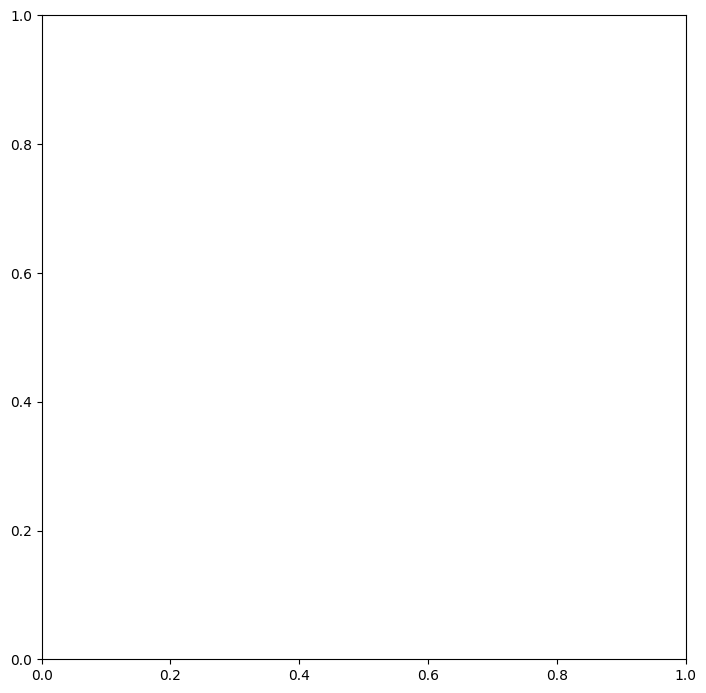

In [37]:

from collections import deque

n = ((1,0),(-1,0),(0,1),(0,-1))

def bfs(i,j,visiting,output_resize,visit):
    count = 0
    queue = deque()
    queue.append((i,j))
    while queue:
        i,j = queue.popleft()
        if visit[i][j]==0:
            visit[i][j]=visiting
            count +=1
            for k in range(4):
                i1 = i+n[k][0]
                j1 = j+n[k][1]
        
                if(i1<0 or j1<0 or i1>=512 or j1 >=512):
                    continue
                if visit[i1][j1]!=0 or output_resize[i1][j1]==0:
                    continue
                queue.append((i1,j1))
    return visit,count

model_path1 = 'models/weight_loss_epoch_106.pth'
model_path2 = 'efficientb7_models\weight_loss_epoch_110.pth'
model_path3 = 'resnest269e_models\weight_loss_epoch_90.pth'


#model = SwinUnet(config,img_size=config["image_size"],num_classes=config["num_classes"]).to(device)
test_model1 = smp.UnetPlusPlus(
    encoder_name="resnext101_32x16d",        # choose encoder, e.g. mobilenet_v2 or efficientnet-b7
    encoder_weights="instagram",     # use `imagenet` pre-trained weights for encoder initialization
    in_channels=3,                  # model input channels (1 for gray-scale images, 3 for RGB, etc.)
    classes=4,                      # model output channels (number of classes in your dataset)
).to(device)
test_model1.load_state_dict(torch.load(model_path1))

#model = SwinUnet(config,img_size=config["image_size"],num_classes=config["num_classes"]).to(device)
test_model2 = smp.UnetPlusPlus(
    encoder_name="efficientnet-b7",        # choose encoder, e.g. mobilenet_v2 or efficientnet-b7
    encoder_weights="imagenet",     # use `imagenet` pre-trained weights for encoder initialization
    in_channels=3,                  # model input channels (1 for gray-scale images, 3 for RGB, etc.)
    classes=4,                      # model output channels (number of classes in your dataset)
).to(device)
test_model2.load_state_dict(torch.load(model_path2))

test_model3 = smp.Unet(
    encoder_name="timm-resnest269e",        # choose encoder, e.g. mobilenet_v2 or efficientnet-b7
    encoder_weights="imagenet",     # use `imagenet` pre-trained weights for encoder initialization
    in_channels=3,                  # model input channels (1 for gray-scale images, 3 for RGB, etc.)
    classes=4,                      # model output channels (number of classes in your dataset)
).to(device)
test_model3.load_state_dict(torch.load(model_path3))


testloader = DataLoader(testdataset,batch_size = 1, shuffle = False)
test_model1.eval()
test_model2.eval()
test_model3.eval()


out_dict = []
outputs = []
inputs = []



for k,batch in enumerate(testloader):
    images = batch
    #images1 = images.permute(0,3,1,2).to(device)
    images2 = images.permute(0,3,1,2).to(device)
    images3 = images.permute(0,3,1,2).to(device)
    
    #output1 = test_model1(images1.float())
    #print(images.float().shape)
    output2 = test_model2(images2.float())
    #print(images.float().shape)
    output3 = test_model3(images3.float())
    #print(images.float().shape)
    
    # output_resize1 = F.interpolate(output1.float(),512,mode="bilinear",align_corners =False)
    # output_resize1 = output_resize1.squeeze(dim=0).permute(1,2,0).argmax(dim=2).cpu()

    output_resize2 = F.interpolate(output2.float(),512,mode="bilinear",align_corners =False)
    output_resize2 = output_resize2.squeeze(dim=0).permute(1,2,0).argmax(dim=2).cpu()

    output_resize3 = F.interpolate(output3.float(),512,mode="bilinear",align_corners =False)
    output_resize3 = output_resize3.squeeze(dim=0).permute(1,2,0).argmax(dim=2).cpu()

    output_resize =  output_resize2 + output_resize3
    output_resize = output_resize/2
    
    visit = np.zeros_like(output_resize)
    visiting = 1
    count_array = [0]
    for i in range(512):
        for j in range(512):
            if visit[i][j]==0 and output_resize[i][j]!=0:
                print(visiting)
                visit,count = bfs(i,j,visiting,output_resize,visit)
                visiting += 1
                count_array.append(count)
                
    count_array = np.array(count_array)
    max_idx = count_array.argmax(axis=0)
    
    for i in range(512):
        for j in range(512):
            if visit[i][j]!=max_idx:
                output_resize[i][j]=0
                
    
    
    
    inputs.append(images)
    outputs.append(output_resize)

    
#    import pdb as pd; pd.set_trace()
    
    
    
    one_label = []
    for j in range(4):
        one = torch.zeros(output_resize.shape)
        one[output_resize==j]=1
            
        one_label.append(one.unsqueeze(dim=2))
        
#    plt.figure(figsize=(50,50))
#    plt.subplot(1,4,1)
#    plt.imshow(images.squeeze().permute(1,2,0).cpu())
#    plt.subplot(1,4,2)
#    plt.imshow(one_label[1].cpu())
#    plt.subplot(1,4,3)
#    plt.imshow(one_label[2].cpu())
#    plt.subplot(1,4,4)
#    plt.imshow(one_label[3].cpu())
#    plt.axis('off')
#    plt.show()
    
#    import pdb as pd; pd.set_trace()
        
    for j in range(1,4):
        out = one_label[j].squeeze().numpy()
        encode = rle_encode(out)
        out_dict.append((f'case{101+k}_{j}', ' '.join(str(_) for _ in encode)))

print (len(inputs))
plt.figure(figsize=(50,500))
#plt.subplot(1,2,1)
#plt.imshow(inputs[0].squeeze().permute(1,2,0).cpu())
#plt.subplot(1,2,2)
#plt.imshow(outputs[0].cpu())

for i in range(len(inputs)):

    plt.subplot(50,2,i*2+1)
    plt.imshow(inputs[i].squeeze().permute(1,2,0).cpu())
    plt.subplot(50,2,i*2+2)
    plt.imshow(outputs[i].cpu())


plt.axis('off')
plt.show()    
        
        
    